# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

mkdir: cannot create directory ‘data’: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

In [5]:
print(trainset["X"].shape)

(32, 32, 3, 73257)


Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

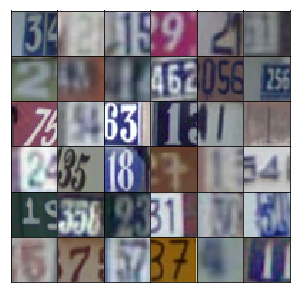

In [6]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [7]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [8]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [9]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [10]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        fc = tf.layers.dense(inputs=z, units=4*4*512, activation=None)
        conv1 = tf.reshape(fc, shape=(-1, 4, 4, 512))
        conv1 = tf.layers.batch_normalization(inputs=conv1, training=training)
        conv1 = tf.maximum(conv1, alpha*conv1)
        # > 4x5x1024
        
        conv2 = tf.layers.conv2d_transpose(inputs=conv1, filters=256, kernel_size=5, strides=2, padding='SAME', activation=None)
        conv2 = tf.layers.batch_normalization(inputs=conv2, training=training)
        conv2 = tf.maximum(conv2, alpha*conv2)
        # > 8x8x512
        
        conv3 = tf.layers.conv2d_transpose(inputs=conv2, filters=128, kernel_size=5, strides=2, padding='SAME', activation=None)
        conv3 = tf.layers.batch_normalization(inputs=conv3, training=training)
        conv3 = tf.maximum(conv3, alpha*conv3)
        # > 16x16x128
        
        # Output layer, 32x32x3
        logits = tf.layers.conv2d_transpose(inputs=conv3, filters=output_dim, kernel_size=5, strides=2, padding='SAME', activation=None)
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [11]:
def discriminator(x, reuse=False, alpha=0.2):
    def lRU(x, alpha):
        return tf.maximum(x, x * alpha)
    
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        conv1 = tf.layers.conv2d(inputs=x, filters=64, kernel_size=5, strides=2, activation=None)
        #conv1 = tf.layers.batch_normalization(inputs=conv1, training=True)
        conv1 = tf.maximum(conv1, alpha*conv1)
        # > 16x16x64
        
        conv2 = tf.layers.conv2d(inputs=conv1, filters=128, kernel_size=5, strides=2, activation=None)
        conv2 = tf.layers.batch_normalization(inputs=conv2, training=True)
        conv2 = tf.maximum(conv2, alpha*conv2)
        # > 8x8x256
        
        conv3 = tf.layers.conv2d(inputs=conv2, filters=256, kernel_size=5, strides=2, activation=None)
        conv3 = tf.layers.batch_normalization(inputs=conv3, training=True)
        conv3 = tf.maximum(conv3, alpha*conv3)
        # > 4x4x512
        
        flat = tf.reshape(conv3, (-1, 4*4*256))
        logits = tf.layers.dense(inputs=conv3, units=1, activation=None)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [12]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [13]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [14]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=0.2)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [15]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [16]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [17]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 1.5180... Generator Loss: 0.5777
Epoch 1/25... Discriminator Loss: 1.4985... Generator Loss: 0.5901
Epoch 1/25... Discriminator Loss: 1.2494... Generator Loss: 0.6121
Epoch 1/25... Discriminator Loss: 1.2270... Generator Loss: 0.6613
Epoch 1/25... Discriminator Loss: 1.2837... Generator Loss: 0.6916
Epoch 1/25... Discriminator Loss: 1.1257... Generator Loss: 0.7433
Epoch 1/25... Discriminator Loss: 1.2200... Generator Loss: 0.7716
Epoch 1/25... Discriminator Loss: 1.4072... Generator Loss: 0.8031
Epoch 1/25... Discriminator Loss: 0.9957... Generator Loss: 0.8287
Epoch 1/25... Discriminator Loss: 1.0593... Generator Loss: 0.8589


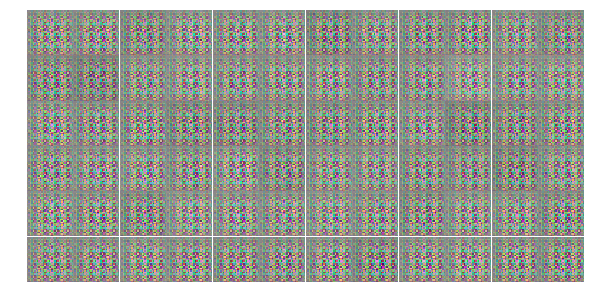

Epoch 1/25... Discriminator Loss: 1.0428... Generator Loss: 0.8882
Epoch 1/25... Discriminator Loss: 0.8792... Generator Loss: 0.8870
Epoch 1/25... Discriminator Loss: 0.8794... Generator Loss: 0.9005
Epoch 1/25... Discriminator Loss: 0.9032... Generator Loss: 0.9424
Epoch 1/25... Discriminator Loss: 1.0791... Generator Loss: 0.9487
Epoch 1/25... Discriminator Loss: 0.7634... Generator Loss: 0.9879
Epoch 1/25... Discriminator Loss: 0.8931... Generator Loss: 1.0441
Epoch 1/25... Discriminator Loss: 1.0174... Generator Loss: 1.0402
Epoch 1/25... Discriminator Loss: 0.9505... Generator Loss: 1.0459
Epoch 1/25... Discriminator Loss: 0.8688... Generator Loss: 1.0506


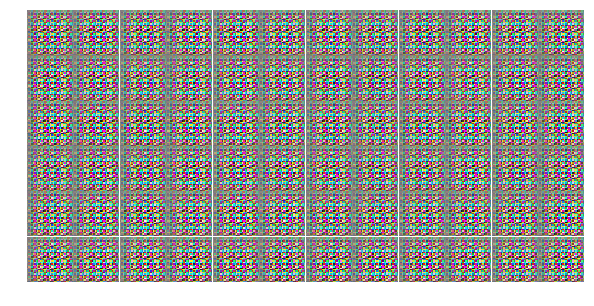

Epoch 1/25... Discriminator Loss: 0.8938... Generator Loss: 1.0578
Epoch 1/25... Discriminator Loss: 0.9762... Generator Loss: 1.0670
Epoch 1/25... Discriminator Loss: 0.8421... Generator Loss: 1.0178
Epoch 1/25... Discriminator Loss: 0.8372... Generator Loss: 0.9090
Epoch 1/25... Discriminator Loss: 0.9950... Generator Loss: 0.8194
Epoch 1/25... Discriminator Loss: 1.0524... Generator Loss: 0.7342
Epoch 1/25... Discriminator Loss: 1.0494... Generator Loss: 0.6746
Epoch 1/25... Discriminator Loss: 1.0140... Generator Loss: 0.6902
Epoch 1/25... Discriminator Loss: 0.9711... Generator Loss: 0.7564
Epoch 1/25... Discriminator Loss: 0.9714... Generator Loss: 0.7856


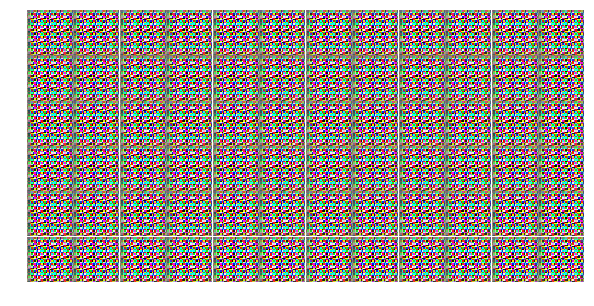

Epoch 1/25... Discriminator Loss: 0.6949... Generator Loss: 0.9699
Epoch 1/25... Discriminator Loss: 0.8688... Generator Loss: 0.8646
Epoch 1/25... Discriminator Loss: 0.6795... Generator Loss: 0.9129
Epoch 1/25... Discriminator Loss: 0.6824... Generator Loss: 0.9421
Epoch 1/25... Discriminator Loss: 0.5910... Generator Loss: 0.9984
Epoch 1/25... Discriminator Loss: 0.5780... Generator Loss: 1.0416
Epoch 1/25... Discriminator Loss: 0.6205... Generator Loss: 1.0065
Epoch 1/25... Discriminator Loss: 0.6332... Generator Loss: 0.9942
Epoch 1/25... Discriminator Loss: 0.5671... Generator Loss: 1.0504
Epoch 1/25... Discriminator Loss: 0.5627... Generator Loss: 1.1099


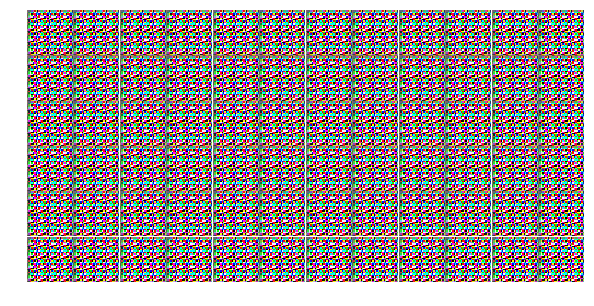

Epoch 1/25... Discriminator Loss: 0.5114... Generator Loss: 1.0715
Epoch 1/25... Discriminator Loss: 0.4784... Generator Loss: 1.1151
Epoch 1/25... Discriminator Loss: 0.5116... Generator Loss: 1.1355
Epoch 1/25... Discriminator Loss: 0.5278... Generator Loss: 1.1549
Epoch 1/25... Discriminator Loss: 0.4204... Generator Loss: 1.2935
Epoch 1/25... Discriminator Loss: 0.4766... Generator Loss: 1.1819
Epoch 1/25... Discriminator Loss: 0.4343... Generator Loss: 1.1992
Epoch 1/25... Discriminator Loss: 0.4217... Generator Loss: 1.2199
Epoch 1/25... Discriminator Loss: 0.4053... Generator Loss: 1.2531
Epoch 1/25... Discriminator Loss: 0.3946... Generator Loss: 1.2785


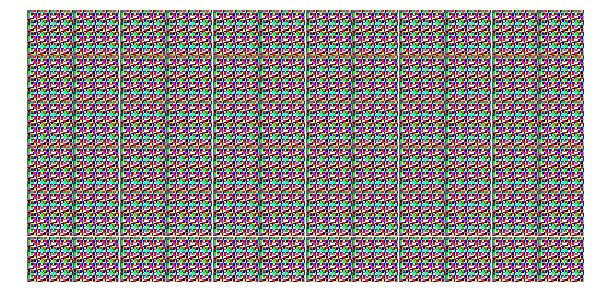

Epoch 1/25... Discriminator Loss: 0.3855... Generator Loss: 1.2895
Epoch 1/25... Discriminator Loss: 0.3770... Generator Loss: 1.3122
Epoch 1/25... Discriminator Loss: 0.3773... Generator Loss: 1.3273
Epoch 1/25... Discriminator Loss: 0.3368... Generator Loss: 1.4456
Epoch 1/25... Discriminator Loss: 0.3371... Generator Loss: 1.3938
Epoch 1/25... Discriminator Loss: 0.3522... Generator Loss: 1.4158
Epoch 1/25... Discriminator Loss: 0.3174... Generator Loss: 1.4565
Epoch 2/25... Discriminator Loss: 0.3257... Generator Loss: 1.4864
Epoch 2/25... Discriminator Loss: 0.3165... Generator Loss: 1.5056
Epoch 2/25... Discriminator Loss: 0.3004... Generator Loss: 1.5592


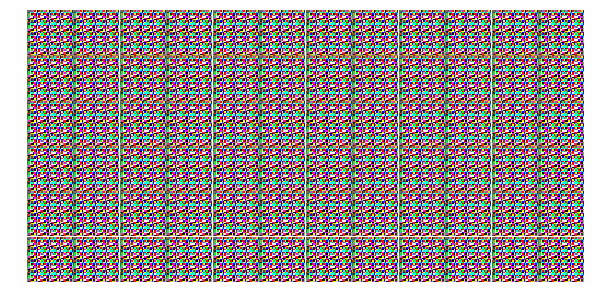

Epoch 2/25... Discriminator Loss: 0.2876... Generator Loss: 1.5640
Epoch 2/25... Discriminator Loss: 0.2817... Generator Loss: 1.5792
Epoch 2/25... Discriminator Loss: 0.2853... Generator Loss: 1.6285
Epoch 2/25... Discriminator Loss: 0.2790... Generator Loss: 1.6320
Epoch 2/25... Discriminator Loss: 0.2634... Generator Loss: 1.6441
Epoch 2/25... Discriminator Loss: 0.2480... Generator Loss: 1.6714
Epoch 2/25... Discriminator Loss: 0.2508... Generator Loss: 1.6998
Epoch 2/25... Discriminator Loss: 0.2547... Generator Loss: 1.7281
Epoch 2/25... Discriminator Loss: 0.2469... Generator Loss: 1.7555
Epoch 2/25... Discriminator Loss: 0.2397... Generator Loss: 1.7795


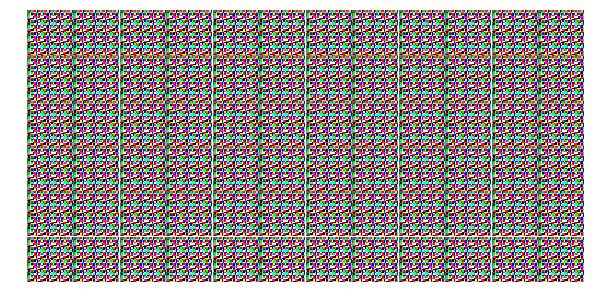

Epoch 2/25... Discriminator Loss: 0.2268... Generator Loss: 1.8089
Epoch 2/25... Discriminator Loss: 0.2141... Generator Loss: 1.8390
Epoch 2/25... Discriminator Loss: 0.2116... Generator Loss: 1.8647
Epoch 2/25... Discriminator Loss: 0.2142... Generator Loss: 1.8930
Epoch 2/25... Discriminator Loss: 0.1934... Generator Loss: 1.9212
Epoch 2/25... Discriminator Loss: 0.1957... Generator Loss: 1.9480
Epoch 2/25... Discriminator Loss: 0.2075... Generator Loss: 1.9737
Epoch 2/25... Discriminator Loss: 0.1893... Generator Loss: 1.9929
Epoch 2/25... Discriminator Loss: 0.1743... Generator Loss: 2.0118
Epoch 2/25... Discriminator Loss: 0.1862... Generator Loss: 2.0562


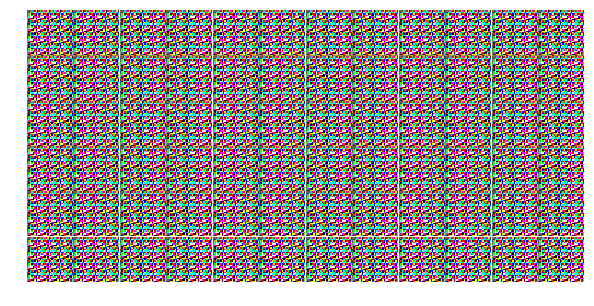

Epoch 2/25... Discriminator Loss: 0.1743... Generator Loss: 2.0612
Epoch 2/25... Discriminator Loss: 0.1612... Generator Loss: 2.3628
Epoch 2/25... Discriminator Loss: 3.0468... Generator Loss: 2.7417
Epoch 2/25... Discriminator Loss: 0.9150... Generator Loss: 0.7227
Epoch 2/25... Discriminator Loss: 0.6476... Generator Loss: 1.0918
Epoch 2/25... Discriminator Loss: 0.7093... Generator Loss: 1.2950
Epoch 2/25... Discriminator Loss: 0.5203... Generator Loss: 1.3103
Epoch 2/25... Discriminator Loss: 0.6194... Generator Loss: 1.3903
Epoch 2/25... Discriminator Loss: 0.6035... Generator Loss: 1.4182
Epoch 2/25... Discriminator Loss: 0.4965... Generator Loss: 1.5191


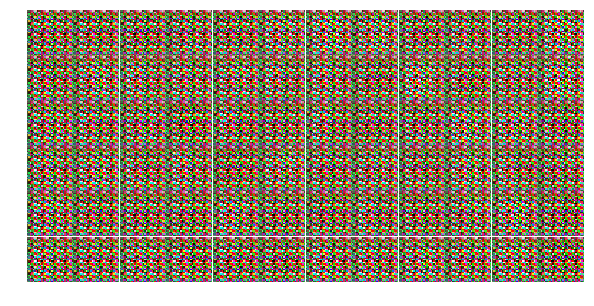

Epoch 2/25... Discriminator Loss: 0.6895... Generator Loss: 1.5983
Epoch 2/25... Discriminator Loss: 0.4321... Generator Loss: 1.5845
Epoch 2/25... Discriminator Loss: 0.4628... Generator Loss: 1.6880
Epoch 2/25... Discriminator Loss: 0.6562... Generator Loss: 1.5959
Epoch 2/25... Discriminator Loss: 0.5086... Generator Loss: 1.5707
Epoch 2/25... Discriminator Loss: 0.4179... Generator Loss: 1.6304
Epoch 2/25... Discriminator Loss: 0.4730... Generator Loss: 1.6209
Epoch 2/25... Discriminator Loss: 0.4329... Generator Loss: 1.6740
Epoch 2/25... Discriminator Loss: 0.5075... Generator Loss: 1.6714
Epoch 2/25... Discriminator Loss: 0.4265... Generator Loss: 1.5917


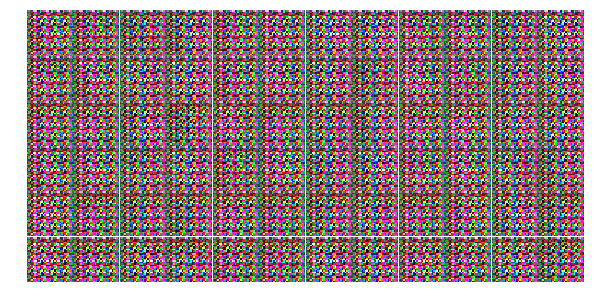

Epoch 2/25... Discriminator Loss: 0.5202... Generator Loss: 1.4350
Epoch 2/25... Discriminator Loss: 0.4373... Generator Loss: 1.6379
Epoch 2/25... Discriminator Loss: 0.4722... Generator Loss: 1.6224
Epoch 2/25... Discriminator Loss: 0.5231... Generator Loss: 1.7273
Epoch 2/25... Discriminator Loss: 0.4966... Generator Loss: 1.6308
Epoch 2/25... Discriminator Loss: 0.7193... Generator Loss: 1.5786
Epoch 2/25... Discriminator Loss: 0.5748... Generator Loss: 1.3152
Epoch 2/25... Discriminator Loss: 0.5377... Generator Loss: 1.5912
Epoch 2/25... Discriminator Loss: 0.7774... Generator Loss: 1.5688
Epoch 2/25... Discriminator Loss: 0.5336... Generator Loss: 1.3887


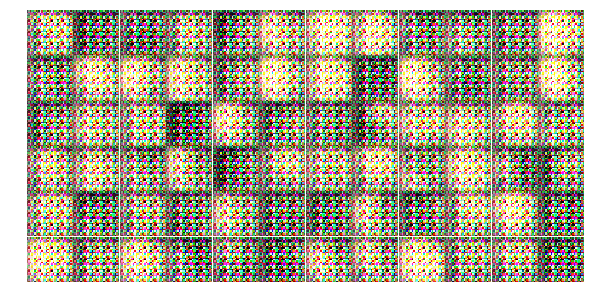

Epoch 2/25... Discriminator Loss: 0.3970... Generator Loss: 1.7582
Epoch 2/25... Discriminator Loss: 0.6303... Generator Loss: 1.6553
Epoch 2/25... Discriminator Loss: 0.3780... Generator Loss: 1.7977
Epoch 2/25... Discriminator Loss: 0.3585... Generator Loss: 1.8097
Epoch 3/25... Discriminator Loss: 0.4440... Generator Loss: 1.7746
Epoch 3/25... Discriminator Loss: 0.3220... Generator Loss: 1.8512
Epoch 3/25... Discriminator Loss: 0.5656... Generator Loss: 1.8168
Epoch 3/25... Discriminator Loss: 0.5175... Generator Loss: 1.7470
Epoch 3/25... Discriminator Loss: 0.3759... Generator Loss: 1.8137
Epoch 3/25... Discriminator Loss: 0.3631... Generator Loss: 1.8119


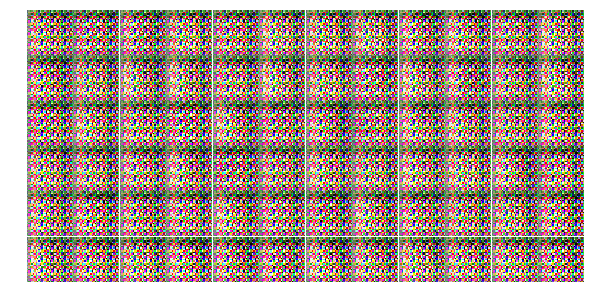

Epoch 3/25... Discriminator Loss: 0.2649... Generator Loss: 2.0125
Epoch 3/25... Discriminator Loss: 0.3143... Generator Loss: 1.8813
Epoch 3/25... Discriminator Loss: 0.3284... Generator Loss: 1.9486
Epoch 3/25... Discriminator Loss: 0.3008... Generator Loss: 1.9904
Epoch 3/25... Discriminator Loss: 0.3238... Generator Loss: 2.0482
Epoch 3/25... Discriminator Loss: 0.3560... Generator Loss: 1.9929
Epoch 3/25... Discriminator Loss: 0.2777... Generator Loss: 2.0207
Epoch 3/25... Discriminator Loss: 0.3376... Generator Loss: 1.9839
Epoch 3/25... Discriminator Loss: 1.7385... Generator Loss: 2.0630
Epoch 3/25... Discriminator Loss: 0.5115... Generator Loss: 1.8239


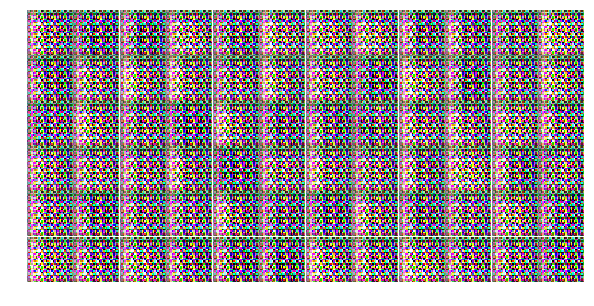

Epoch 3/25... Discriminator Loss: 0.3217... Generator Loss: 1.8606
Epoch 3/25... Discriminator Loss: 0.4216... Generator Loss: 1.7067
Epoch 3/25... Discriminator Loss: 0.3761... Generator Loss: 1.8321
Epoch 3/25... Discriminator Loss: 0.7118... Generator Loss: 1.7803
Epoch 3/25... Discriminator Loss: 0.5046... Generator Loss: 1.4181
Epoch 3/25... Discriminator Loss: 1.1189... Generator Loss: 0.8835
Epoch 3/25... Discriminator Loss: 1.4623... Generator Loss: 0.8611
Epoch 3/25... Discriminator Loss: 1.0360... Generator Loss: 0.9274
Epoch 3/25... Discriminator Loss: 0.6662... Generator Loss: 1.3541
Epoch 3/25... Discriminator Loss: 0.9188... Generator Loss: 1.0834


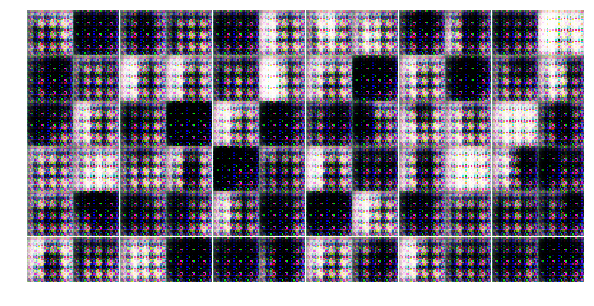

Epoch 3/25... Discriminator Loss: 1.0300... Generator Loss: 1.3866
Epoch 3/25... Discriminator Loss: 0.9969... Generator Loss: 0.9092
Epoch 3/25... Discriminator Loss: 1.3632... Generator Loss: 1.1069
Epoch 3/25... Discriminator Loss: 1.1472... Generator Loss: 1.2301
Epoch 3/25... Discriminator Loss: 0.8535... Generator Loss: 1.3453
Epoch 3/25... Discriminator Loss: 1.0582... Generator Loss: 1.2803
Epoch 3/25... Discriminator Loss: 1.0999... Generator Loss: 0.9644
Epoch 3/25... Discriminator Loss: 1.0036... Generator Loss: 1.1437
Epoch 3/25... Discriminator Loss: 1.1323... Generator Loss: 1.0827
Epoch 3/25... Discriminator Loss: 1.1530... Generator Loss: 0.8410


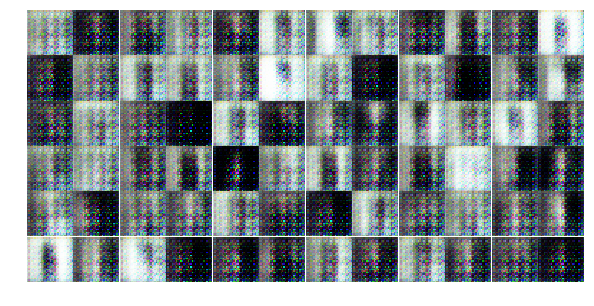

Epoch 3/25... Discriminator Loss: 1.2796... Generator Loss: 0.9410
Epoch 3/25... Discriminator Loss: 0.9116... Generator Loss: 0.9939
Epoch 3/25... Discriminator Loss: 1.1772... Generator Loss: 0.6148
Epoch 3/25... Discriminator Loss: 0.9935... Generator Loss: 1.1105
Epoch 3/25... Discriminator Loss: 1.1228... Generator Loss: 1.3712
Epoch 3/25... Discriminator Loss: 1.4396... Generator Loss: 0.4761
Epoch 3/25... Discriminator Loss: 1.2183... Generator Loss: 0.9593
Epoch 3/25... Discriminator Loss: 1.2610... Generator Loss: 0.6218
Epoch 3/25... Discriminator Loss: 1.4369... Generator Loss: 1.0032
Epoch 3/25... Discriminator Loss: 1.2378... Generator Loss: 0.8261


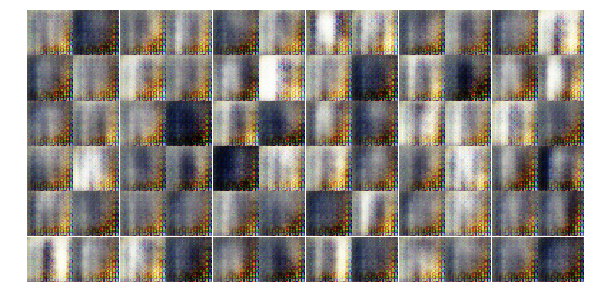

Epoch 3/25... Discriminator Loss: 1.2756... Generator Loss: 0.8321
Epoch 3/25... Discriminator Loss: 1.3375... Generator Loss: 0.8500
Epoch 3/25... Discriminator Loss: 1.2903... Generator Loss: 0.7445
Epoch 3/25... Discriminator Loss: 1.3797... Generator Loss: 0.7395
Epoch 3/25... Discriminator Loss: 1.3989... Generator Loss: 0.7622
Epoch 3/25... Discriminator Loss: 1.3128... Generator Loss: 0.7282
Epoch 3/25... Discriminator Loss: 1.4539... Generator Loss: 0.8029
Epoch 3/25... Discriminator Loss: 1.3241... Generator Loss: 0.7108
Epoch 3/25... Discriminator Loss: 1.3344... Generator Loss: 0.8650
Epoch 3/25... Discriminator Loss: 1.3117... Generator Loss: 0.7587


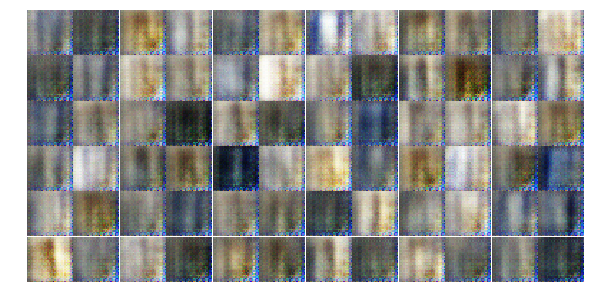

Epoch 3/25... Discriminator Loss: 1.3385... Generator Loss: 0.6732
Epoch 4/25... Discriminator Loss: 1.4044... Generator Loss: 0.8622
Epoch 4/25... Discriminator Loss: 1.3180... Generator Loss: 0.8186
Epoch 4/25... Discriminator Loss: 1.2646... Generator Loss: 0.7040
Epoch 4/25... Discriminator Loss: 1.3270... Generator Loss: 0.6769
Epoch 4/25... Discriminator Loss: 1.4057... Generator Loss: 0.6440
Epoch 4/25... Discriminator Loss: 1.4309... Generator Loss: 0.7132
Epoch 4/25... Discriminator Loss: 1.3293... Generator Loss: 0.7208
Epoch 4/25... Discriminator Loss: 1.3974... Generator Loss: 0.6900
Epoch 4/25... Discriminator Loss: 1.4425... Generator Loss: 0.7814


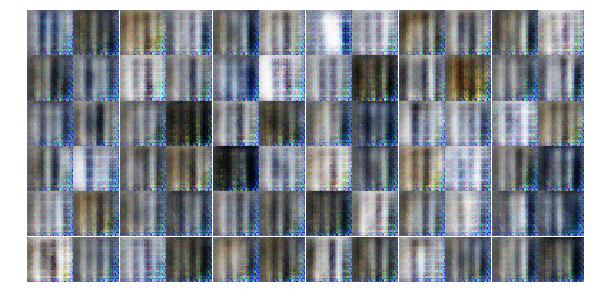

Epoch 4/25... Discriminator Loss: 1.4206... Generator Loss: 0.6859
Epoch 4/25... Discriminator Loss: 1.3198... Generator Loss: 0.7455
Epoch 4/25... Discriminator Loss: 1.3753... Generator Loss: 0.8382
Epoch 4/25... Discriminator Loss: 1.4373... Generator Loss: 0.6719
Epoch 4/25... Discriminator Loss: 1.4002... Generator Loss: 0.6604
Epoch 4/25... Discriminator Loss: 1.4049... Generator Loss: 0.6870
Epoch 4/25... Discriminator Loss: 1.3905... Generator Loss: 0.7124
Epoch 4/25... Discriminator Loss: 1.3597... Generator Loss: 0.7277
Epoch 4/25... Discriminator Loss: 1.4054... Generator Loss: 0.7475
Epoch 4/25... Discriminator Loss: 1.3734... Generator Loss: 0.6958


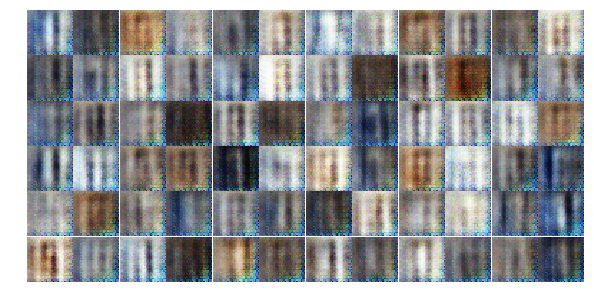

Epoch 4/25... Discriminator Loss: 1.3169... Generator Loss: 0.8337
Epoch 4/25... Discriminator Loss: 1.3202... Generator Loss: 0.7105
Epoch 4/25... Discriminator Loss: 1.3512... Generator Loss: 0.7782
Epoch 4/25... Discriminator Loss: 1.3968... Generator Loss: 0.6931
Epoch 4/25... Discriminator Loss: 1.2910... Generator Loss: 0.7615
Epoch 4/25... Discriminator Loss: 1.3023... Generator Loss: 0.7080
Epoch 4/25... Discriminator Loss: 1.3039... Generator Loss: 0.7560
Epoch 4/25... Discriminator Loss: 1.3444... Generator Loss: 0.7637
Epoch 4/25... Discriminator Loss: 1.3443... Generator Loss: 0.6758
Epoch 4/25... Discriminator Loss: 1.3369... Generator Loss: 0.8040


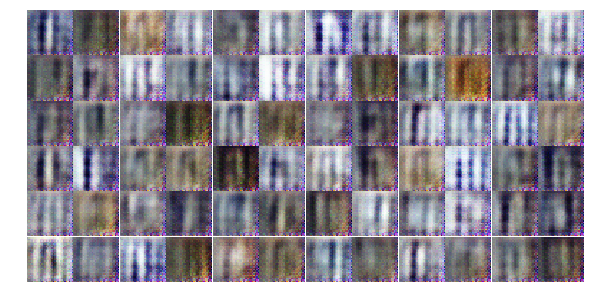

Epoch 4/25... Discriminator Loss: 1.2589... Generator Loss: 0.7583
Epoch 4/25... Discriminator Loss: 1.3623... Generator Loss: 0.7446
Epoch 4/25... Discriminator Loss: 1.3183... Generator Loss: 0.7633
Epoch 4/25... Discriminator Loss: 1.2894... Generator Loss: 0.7439
Epoch 4/25... Discriminator Loss: 1.3441... Generator Loss: 0.6933
Epoch 4/25... Discriminator Loss: 1.3500... Generator Loss: 0.7152
Epoch 4/25... Discriminator Loss: 1.3526... Generator Loss: 0.6611
Epoch 4/25... Discriminator Loss: 1.3374... Generator Loss: 0.7514
Epoch 4/25... Discriminator Loss: 1.3433... Generator Loss: 0.6911
Epoch 4/25... Discriminator Loss: 1.4074... Generator Loss: 0.6855


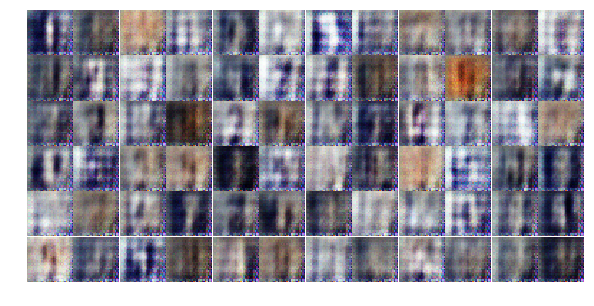

Epoch 4/25... Discriminator Loss: 1.2607... Generator Loss: 0.7950
Epoch 4/25... Discriminator Loss: 1.3857... Generator Loss: 0.7030
Epoch 4/25... Discriminator Loss: 1.3683... Generator Loss: 0.7016
Epoch 4/25... Discriminator Loss: 1.3175... Generator Loss: 0.7081
Epoch 4/25... Discriminator Loss: 1.3368... Generator Loss: 0.7258
Epoch 4/25... Discriminator Loss: 1.4157... Generator Loss: 0.6870
Epoch 4/25... Discriminator Loss: 1.3582... Generator Loss: 0.6858
Epoch 4/25... Discriminator Loss: 1.4175... Generator Loss: 0.7091
Epoch 4/25... Discriminator Loss: 1.3392... Generator Loss: 0.6891
Epoch 4/25... Discriminator Loss: 1.3823... Generator Loss: 0.7138


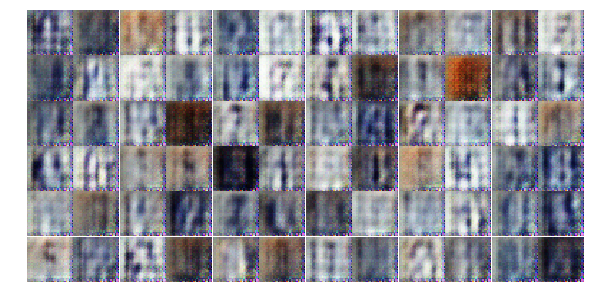

Epoch 4/25... Discriminator Loss: 1.3351... Generator Loss: 0.7637
Epoch 4/25... Discriminator Loss: 1.3620... Generator Loss: 0.7108
Epoch 4/25... Discriminator Loss: 1.4088... Generator Loss: 0.6556
Epoch 4/25... Discriminator Loss: 1.3999... Generator Loss: 0.6890
Epoch 4/25... Discriminator Loss: 1.3916... Generator Loss: 0.6635
Epoch 4/25... Discriminator Loss: 1.3293... Generator Loss: 0.7025
Epoch 4/25... Discriminator Loss: 1.3269... Generator Loss: 0.6478
Epoch 4/25... Discriminator Loss: 1.3287... Generator Loss: 0.6957
Epoch 4/25... Discriminator Loss: 1.3683... Generator Loss: 0.7111
Epoch 5/25... Discriminator Loss: 1.3894... Generator Loss: 0.6733


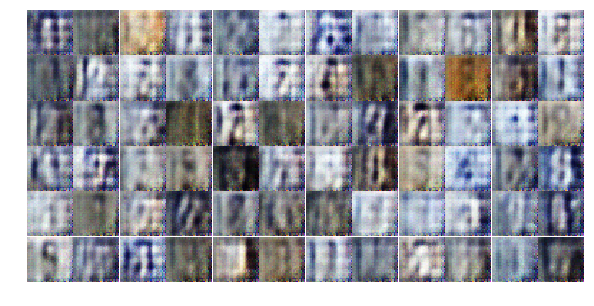

Epoch 5/25... Discriminator Loss: 1.3766... Generator Loss: 0.7199
Epoch 5/25... Discriminator Loss: 1.4149... Generator Loss: 0.7101
Epoch 5/25... Discriminator Loss: 1.3727... Generator Loss: 0.6940
Epoch 5/25... Discriminator Loss: 1.4034... Generator Loss: 0.6942
Epoch 5/25... Discriminator Loss: 1.4101... Generator Loss: 0.7539
Epoch 5/25... Discriminator Loss: 1.3711... Generator Loss: 0.7444
Epoch 5/25... Discriminator Loss: 1.4061... Generator Loss: 0.6081
Epoch 5/25... Discriminator Loss: 1.3697... Generator Loss: 0.6800
Epoch 5/25... Discriminator Loss: 1.3688... Generator Loss: 0.7047
Epoch 5/25... Discriminator Loss: 1.3873... Generator Loss: 0.6941


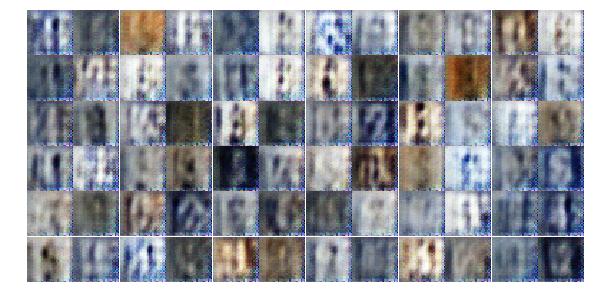

Epoch 5/25... Discriminator Loss: 1.3901... Generator Loss: 0.6781
Epoch 5/25... Discriminator Loss: 1.3711... Generator Loss: 0.7342
Epoch 5/25... Discriminator Loss: 1.3462... Generator Loss: 0.7353
Epoch 5/25... Discriminator Loss: 1.4576... Generator Loss: 0.6808
Epoch 5/25... Discriminator Loss: 1.3261... Generator Loss: 0.7489
Epoch 5/25... Discriminator Loss: 1.3635... Generator Loss: 0.6892
Epoch 5/25... Discriminator Loss: 1.4335... Generator Loss: 0.6629
Epoch 5/25... Discriminator Loss: 1.4027... Generator Loss: 0.7341
Epoch 5/25... Discriminator Loss: 1.3817... Generator Loss: 0.7357
Epoch 5/25... Discriminator Loss: 1.4021... Generator Loss: 0.6778


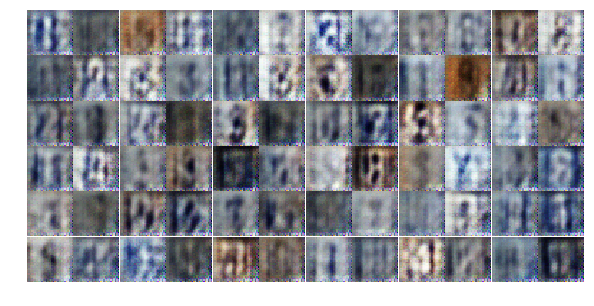

Epoch 5/25... Discriminator Loss: 1.3749... Generator Loss: 0.6833
Epoch 5/25... Discriminator Loss: 1.3413... Generator Loss: 0.7538
Epoch 5/25... Discriminator Loss: 1.3622... Generator Loss: 0.6955
Epoch 5/25... Discriminator Loss: 1.3712... Generator Loss: 0.7536
Epoch 5/25... Discriminator Loss: 1.3376... Generator Loss: 0.6639
Epoch 5/25... Discriminator Loss: 1.3558... Generator Loss: 0.7528
Epoch 5/25... Discriminator Loss: 1.3548... Generator Loss: 0.7309
Epoch 5/25... Discriminator Loss: 1.3886... Generator Loss: 0.6155
Epoch 5/25... Discriminator Loss: 1.3976... Generator Loss: 0.7145
Epoch 5/25... Discriminator Loss: 1.3756... Generator Loss: 0.6364


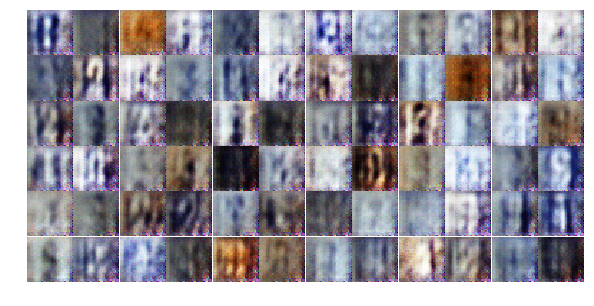

Epoch 5/25... Discriminator Loss: 1.3806... Generator Loss: 0.7320
Epoch 5/25... Discriminator Loss: 1.3626... Generator Loss: 0.7058
Epoch 5/25... Discriminator Loss: 1.3387... Generator Loss: 0.7330
Epoch 5/25... Discriminator Loss: 1.3552... Generator Loss: 0.7389
Epoch 5/25... Discriminator Loss: 1.3678... Generator Loss: 0.6839
Epoch 5/25... Discriminator Loss: 1.3917... Generator Loss: 0.7013
Epoch 5/25... Discriminator Loss: 1.4086... Generator Loss: 0.6886
Epoch 5/25... Discriminator Loss: 1.3262... Generator Loss: 0.7730
Epoch 5/25... Discriminator Loss: 1.3614... Generator Loss: 0.6807
Epoch 5/25... Discriminator Loss: 1.3938... Generator Loss: 0.6691


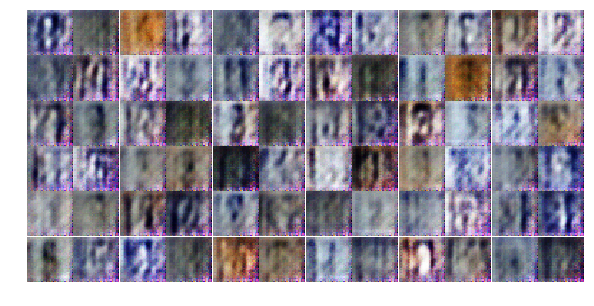

Epoch 5/25... Discriminator Loss: 1.4012... Generator Loss: 0.7102
Epoch 5/25... Discriminator Loss: 1.2922... Generator Loss: 0.7110
Epoch 5/25... Discriminator Loss: 1.4357... Generator Loss: 0.7105
Epoch 5/25... Discriminator Loss: 1.3622... Generator Loss: 0.7408
Epoch 5/25... Discriminator Loss: 1.3822... Generator Loss: 0.6903
Epoch 5/25... Discriminator Loss: 1.3706... Generator Loss: 0.7262
Epoch 5/25... Discriminator Loss: 1.3898... Generator Loss: 0.6963
Epoch 5/25... Discriminator Loss: 1.3976... Generator Loss: 0.7122
Epoch 5/25... Discriminator Loss: 1.3546... Generator Loss: 0.6810
Epoch 5/25... Discriminator Loss: 1.3166... Generator Loss: 0.7556


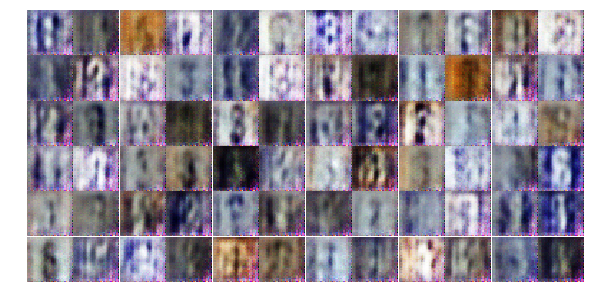

Epoch 5/25... Discriminator Loss: 1.4086... Generator Loss: 0.6953
Epoch 5/25... Discriminator Loss: 1.3894... Generator Loss: 0.7106
Epoch 5/25... Discriminator Loss: 1.3707... Generator Loss: 0.7645
Epoch 5/25... Discriminator Loss: 1.3876... Generator Loss: 0.6574
Epoch 5/25... Discriminator Loss: 1.3619... Generator Loss: 0.7487
Epoch 5/25... Discriminator Loss: 1.3810... Generator Loss: 0.7153
Epoch 6/25... Discriminator Loss: 1.3187... Generator Loss: 0.7129
Epoch 6/25... Discriminator Loss: 1.3287... Generator Loss: 0.7017
Epoch 6/25... Discriminator Loss: 1.3468... Generator Loss: 0.6992
Epoch 6/25... Discriminator Loss: 1.3133... Generator Loss: 0.7220


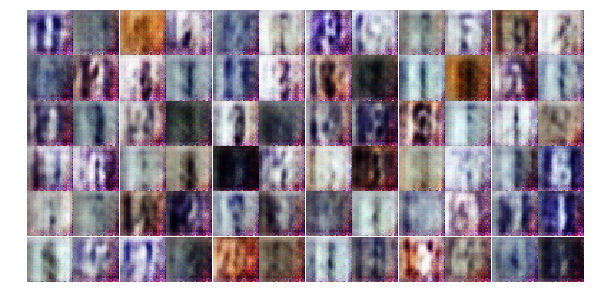

Epoch 6/25... Discriminator Loss: 1.3238... Generator Loss: 0.7955
Epoch 6/25... Discriminator Loss: 1.3247... Generator Loss: 0.6280
Epoch 6/25... Discriminator Loss: 1.3787... Generator Loss: 0.6987
Epoch 6/25... Discriminator Loss: 1.2955... Generator Loss: 0.7311
Epoch 6/25... Discriminator Loss: 1.3600... Generator Loss: 0.7631
Epoch 6/25... Discriminator Loss: 1.3493... Generator Loss: 0.7021
Epoch 6/25... Discriminator Loss: 1.3941... Generator Loss: 0.7019
Epoch 6/25... Discriminator Loss: 1.3480... Generator Loss: 0.6972
Epoch 6/25... Discriminator Loss: 1.3323... Generator Loss: 0.7287
Epoch 6/25... Discriminator Loss: 1.3572... Generator Loss: 0.6978


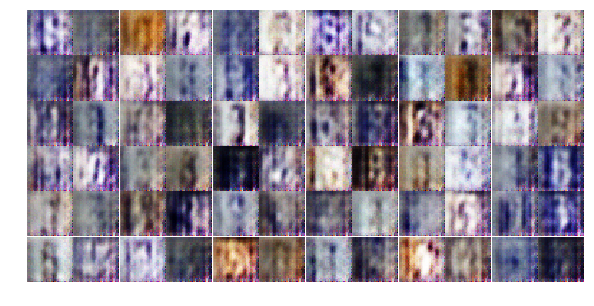

Epoch 6/25... Discriminator Loss: 1.3660... Generator Loss: 0.6261
Epoch 6/25... Discriminator Loss: 1.3146... Generator Loss: 0.7118
Epoch 6/25... Discriminator Loss: 1.3327... Generator Loss: 0.7389
Epoch 6/25... Discriminator Loss: 1.3926... Generator Loss: 0.6904
Epoch 6/25... Discriminator Loss: 1.3610... Generator Loss: 0.7602
Epoch 6/25... Discriminator Loss: 1.3621... Generator Loss: 0.6993
Epoch 6/25... Discriminator Loss: 1.3061... Generator Loss: 0.8171
Epoch 6/25... Discriminator Loss: 1.3471... Generator Loss: 0.6969
Epoch 6/25... Discriminator Loss: 1.3877... Generator Loss: 0.6217
Epoch 6/25... Discriminator Loss: 1.3646... Generator Loss: 0.7016


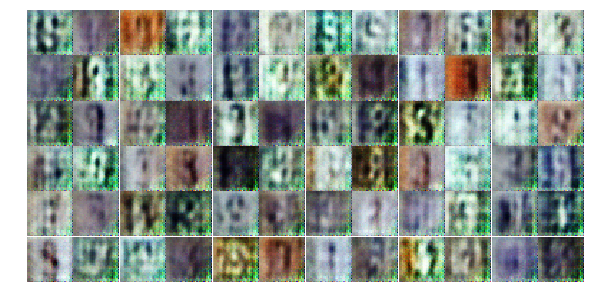

Epoch 6/25... Discriminator Loss: 1.3207... Generator Loss: 0.6890
Epoch 6/25... Discriminator Loss: 1.3373... Generator Loss: 0.7132
Epoch 6/25... Discriminator Loss: 1.3611... Generator Loss: 0.7234
Epoch 6/25... Discriminator Loss: 1.3933... Generator Loss: 0.7069
Epoch 6/25... Discriminator Loss: 1.3459... Generator Loss: 0.6989
Epoch 6/25... Discriminator Loss: 1.3516... Generator Loss: 0.8141
Epoch 6/25... Discriminator Loss: 1.3408... Generator Loss: 0.7455
Epoch 6/25... Discriminator Loss: 1.3313... Generator Loss: 0.6975
Epoch 6/25... Discriminator Loss: 1.3419... Generator Loss: 0.7840
Epoch 6/25... Discriminator Loss: 1.3557... Generator Loss: 0.7166


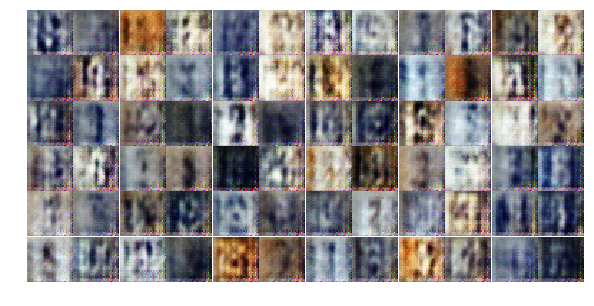

Epoch 6/25... Discriminator Loss: 1.3251... Generator Loss: 0.7141
Epoch 6/25... Discriminator Loss: 1.3056... Generator Loss: 0.6766
Epoch 6/25... Discriminator Loss: 1.3665... Generator Loss: 0.7030
Epoch 6/25... Discriminator Loss: 1.3271... Generator Loss: 0.7129
Epoch 6/25... Discriminator Loss: 1.3041... Generator Loss: 0.7625
Epoch 6/25... Discriminator Loss: 1.2966... Generator Loss: 0.7274
Epoch 6/25... Discriminator Loss: 1.3229... Generator Loss: 0.6707
Epoch 6/25... Discriminator Loss: 1.3048... Generator Loss: 0.7496
Epoch 6/25... Discriminator Loss: 1.3794... Generator Loss: 0.6997
Epoch 6/25... Discriminator Loss: 1.3232... Generator Loss: 0.7511


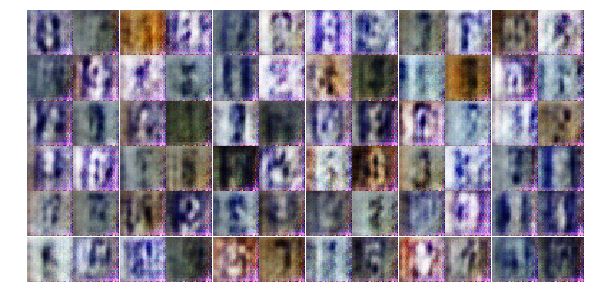

Epoch 6/25... Discriminator Loss: 1.2488... Generator Loss: 0.6842
Epoch 6/25... Discriminator Loss: 1.3384... Generator Loss: 0.7196
Epoch 6/25... Discriminator Loss: 1.3568... Generator Loss: 0.7090
Epoch 6/25... Discriminator Loss: 1.3351... Generator Loss: 0.7974
Epoch 6/25... Discriminator Loss: 1.2445... Generator Loss: 0.6959
Epoch 6/25... Discriminator Loss: 1.3130... Generator Loss: 0.7651
Epoch 6/25... Discriminator Loss: 1.3508... Generator Loss: 0.7539
Epoch 6/25... Discriminator Loss: 1.3538... Generator Loss: 0.7165
Epoch 6/25... Discriminator Loss: 1.3274... Generator Loss: 0.7982
Epoch 6/25... Discriminator Loss: 1.3568... Generator Loss: 0.7096


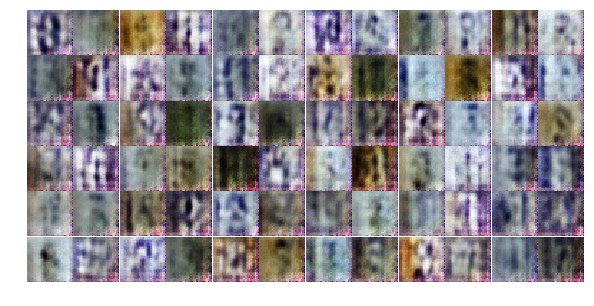

Epoch 6/25... Discriminator Loss: 1.3544... Generator Loss: 0.7715
Epoch 6/25... Discriminator Loss: 1.2890... Generator Loss: 0.7182
Epoch 6/25... Discriminator Loss: 1.3202... Generator Loss: 0.7387
Epoch 7/25... Discriminator Loss: 1.3227... Generator Loss: 0.7855
Epoch 7/25... Discriminator Loss: 1.3338... Generator Loss: 0.7195
Epoch 7/25... Discriminator Loss: 1.2406... Generator Loss: 0.8089
Epoch 7/25... Discriminator Loss: 1.3398... Generator Loss: 0.6802
Epoch 7/25... Discriminator Loss: 1.3004... Generator Loss: 0.6731
Epoch 7/25... Discriminator Loss: 1.3370... Generator Loss: 0.7438
Epoch 7/25... Discriminator Loss: 1.3676... Generator Loss: 0.7212


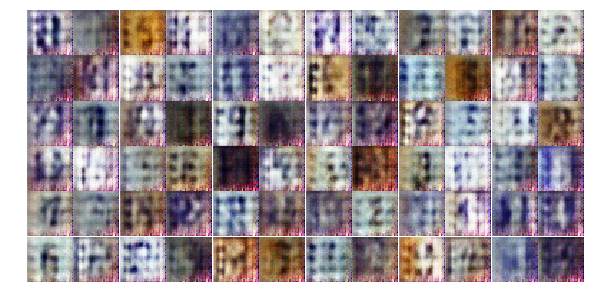

Epoch 7/25... Discriminator Loss: 1.3753... Generator Loss: 0.6859
Epoch 7/25... Discriminator Loss: 1.3276... Generator Loss: 0.7760
Epoch 7/25... Discriminator Loss: 1.3128... Generator Loss: 0.7115
Epoch 7/25... Discriminator Loss: 1.2686... Generator Loss: 0.7879
Epoch 7/25... Discriminator Loss: 1.3166... Generator Loss: 0.8285
Epoch 7/25... Discriminator Loss: 1.2905... Generator Loss: 0.7625
Epoch 7/25... Discriminator Loss: 1.3640... Generator Loss: 0.7325
Epoch 7/25... Discriminator Loss: 1.2942... Generator Loss: 0.7885
Epoch 7/25... Discriminator Loss: 1.3212... Generator Loss: 0.7440
Epoch 7/25... Discriminator Loss: 1.3039... Generator Loss: 0.7745


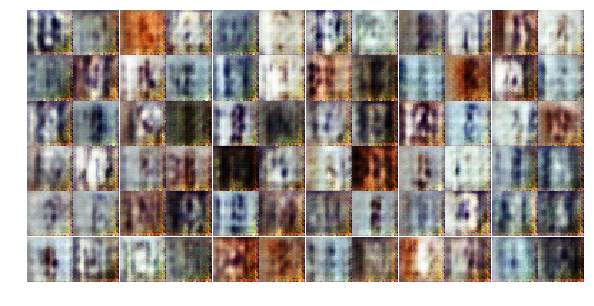

Epoch 7/25... Discriminator Loss: 1.2879... Generator Loss: 0.7620
Epoch 7/25... Discriminator Loss: 1.3020... Generator Loss: 0.6494
Epoch 7/25... Discriminator Loss: 1.2847... Generator Loss: 0.7360
Epoch 7/25... Discriminator Loss: 1.3509... Generator Loss: 0.8838
Epoch 7/25... Discriminator Loss: 1.3279... Generator Loss: 0.7045
Epoch 7/25... Discriminator Loss: 1.2956... Generator Loss: 0.7144
Epoch 7/25... Discriminator Loss: 1.3108... Generator Loss: 0.7173
Epoch 7/25... Discriminator Loss: 1.3129... Generator Loss: 0.6727
Epoch 7/25... Discriminator Loss: 1.3187... Generator Loss: 0.7827
Epoch 7/25... Discriminator Loss: 1.2907... Generator Loss: 0.7486


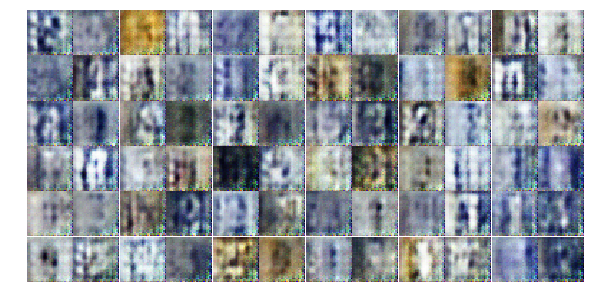

Epoch 7/25... Discriminator Loss: 1.3264... Generator Loss: 0.7012
Epoch 7/25... Discriminator Loss: 1.2944... Generator Loss: 0.7660
Epoch 7/25... Discriminator Loss: 1.3000... Generator Loss: 0.7104
Epoch 7/25... Discriminator Loss: 1.3449... Generator Loss: 0.7815
Epoch 7/25... Discriminator Loss: 1.3267... Generator Loss: 0.7935
Epoch 7/25... Discriminator Loss: 1.3585... Generator Loss: 0.7472
Epoch 7/25... Discriminator Loss: 1.3679... Generator Loss: 0.7269
Epoch 7/25... Discriminator Loss: 1.3080... Generator Loss: 0.7804
Epoch 7/25... Discriminator Loss: 1.3087... Generator Loss: 0.6713
Epoch 7/25... Discriminator Loss: 1.3576... Generator Loss: 0.7517


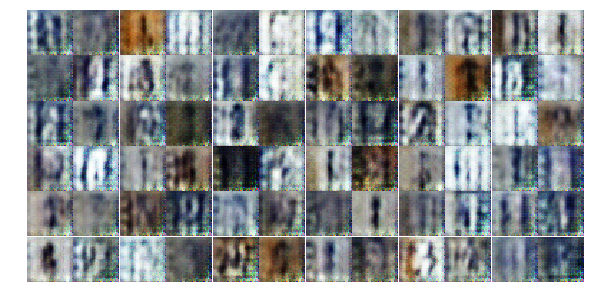

Epoch 7/25... Discriminator Loss: 1.3361... Generator Loss: 0.7283
Epoch 7/25... Discriminator Loss: 1.3540... Generator Loss: 0.6854
Epoch 7/25... Discriminator Loss: 1.3160... Generator Loss: 0.7322
Epoch 7/25... Discriminator Loss: 1.2839... Generator Loss: 0.7194
Epoch 7/25... Discriminator Loss: 1.3234... Generator Loss: 0.7181
Epoch 7/25... Discriminator Loss: 1.2824... Generator Loss: 0.7349
Epoch 7/25... Discriminator Loss: 1.2898... Generator Loss: 0.7163
Epoch 7/25... Discriminator Loss: 1.3300... Generator Loss: 0.6776
Epoch 7/25... Discriminator Loss: 1.2725... Generator Loss: 0.7386
Epoch 7/25... Discriminator Loss: 1.3035... Generator Loss: 0.7967


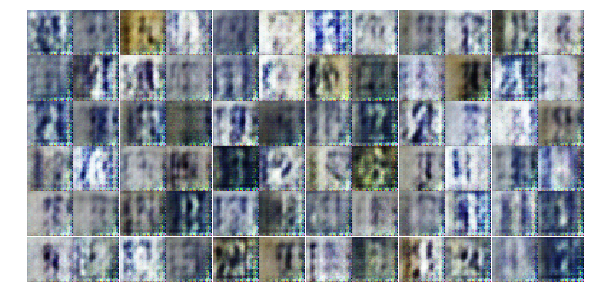

Epoch 7/25... Discriminator Loss: 1.3385... Generator Loss: 0.7490
Epoch 7/25... Discriminator Loss: 1.2994... Generator Loss: 0.7585
Epoch 7/25... Discriminator Loss: 1.3227... Generator Loss: 0.7514
Epoch 7/25... Discriminator Loss: 1.2881... Generator Loss: 0.8053
Epoch 7/25... Discriminator Loss: 1.3249... Generator Loss: 0.7647
Epoch 7/25... Discriminator Loss: 1.2400... Generator Loss: 0.7274
Epoch 7/25... Discriminator Loss: 1.3143... Generator Loss: 0.6855
Epoch 7/25... Discriminator Loss: 1.2550... Generator Loss: 0.7538
Epoch 7/25... Discriminator Loss: 1.3153... Generator Loss: 0.8215
Epoch 7/25... Discriminator Loss: 1.2223... Generator Loss: 0.6918


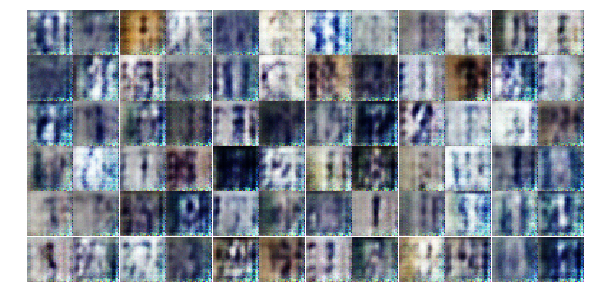

Epoch 7/25... Discriminator Loss: 1.2754... Generator Loss: 0.7215
Epoch 8/25... Discriminator Loss: 1.3020... Generator Loss: 0.7263
Epoch 8/25... Discriminator Loss: 1.3063... Generator Loss: 0.6692
Epoch 8/25... Discriminator Loss: 1.2814... Generator Loss: 0.7567
Epoch 8/25... Discriminator Loss: 1.2510... Generator Loss: 0.7913
Epoch 8/25... Discriminator Loss: 1.3191... Generator Loss: 0.7271
Epoch 8/25... Discriminator Loss: 1.3318... Generator Loss: 0.7699
Epoch 8/25... Discriminator Loss: 1.2636... Generator Loss: 0.8600
Epoch 8/25... Discriminator Loss: 1.3594... Generator Loss: 0.7347
Epoch 8/25... Discriminator Loss: 1.3302... Generator Loss: 0.7462


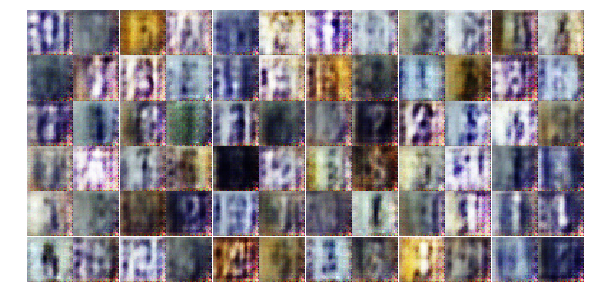

Epoch 8/25... Discriminator Loss: 1.3131... Generator Loss: 0.6954
Epoch 8/25... Discriminator Loss: 1.2965... Generator Loss: 0.7544
Epoch 8/25... Discriminator Loss: 1.3430... Generator Loss: 0.7270
Epoch 8/25... Discriminator Loss: 1.2161... Generator Loss: 0.7530
Epoch 8/25... Discriminator Loss: 1.2762... Generator Loss: 0.6917
Epoch 8/25... Discriminator Loss: 1.3729... Generator Loss: 0.8547
Epoch 8/25... Discriminator Loss: 1.2512... Generator Loss: 0.7316
Epoch 8/25... Discriminator Loss: 1.3267... Generator Loss: 0.7323
Epoch 8/25... Discriminator Loss: 1.3147... Generator Loss: 0.7401
Epoch 8/25... Discriminator Loss: 1.3079... Generator Loss: 0.7668


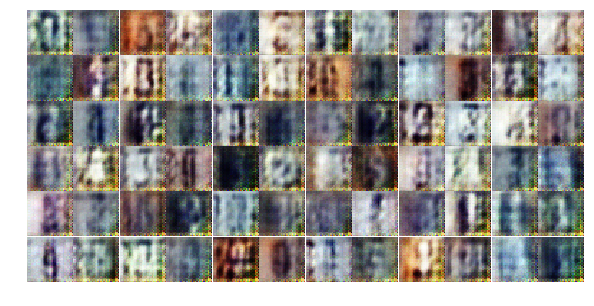

Epoch 8/25... Discriminator Loss: 1.2686... Generator Loss: 0.7031
Epoch 8/25... Discriminator Loss: 1.2509... Generator Loss: 0.7374
Epoch 8/25... Discriminator Loss: 1.2771... Generator Loss: 0.6710
Epoch 8/25... Discriminator Loss: 1.3126... Generator Loss: 0.7618
Epoch 8/25... Discriminator Loss: 1.3193... Generator Loss: 0.7641
Epoch 8/25... Discriminator Loss: 1.3440... Generator Loss: 0.7385
Epoch 8/25... Discriminator Loss: 1.4016... Generator Loss: 0.6997
Epoch 8/25... Discriminator Loss: 1.2622... Generator Loss: 0.7416
Epoch 8/25... Discriminator Loss: 1.2887... Generator Loss: 0.7457
Epoch 8/25... Discriminator Loss: 1.2809... Generator Loss: 0.7310


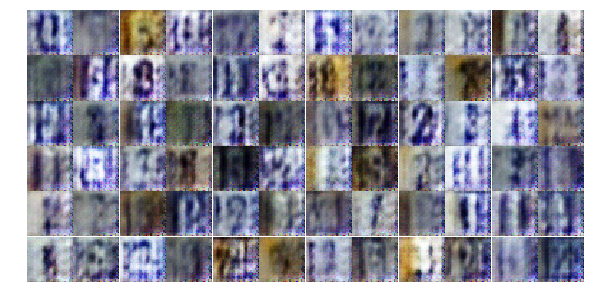

Epoch 8/25... Discriminator Loss: 1.3016... Generator Loss: 0.6919
Epoch 8/25... Discriminator Loss: 1.2981... Generator Loss: 0.7799
Epoch 8/25... Discriminator Loss: 1.3100... Generator Loss: 0.7246
Epoch 8/25... Discriminator Loss: 1.2932... Generator Loss: 0.6564
Epoch 8/25... Discriminator Loss: 1.2485... Generator Loss: 0.6513
Epoch 8/25... Discriminator Loss: 1.2764... Generator Loss: 0.7543
Epoch 8/25... Discriminator Loss: 1.3752... Generator Loss: 0.8636
Epoch 8/25... Discriminator Loss: 1.3323... Generator Loss: 0.7459
Epoch 8/25... Discriminator Loss: 1.2666... Generator Loss: 0.7022
Epoch 8/25... Discriminator Loss: 1.3318... Generator Loss: 0.7686


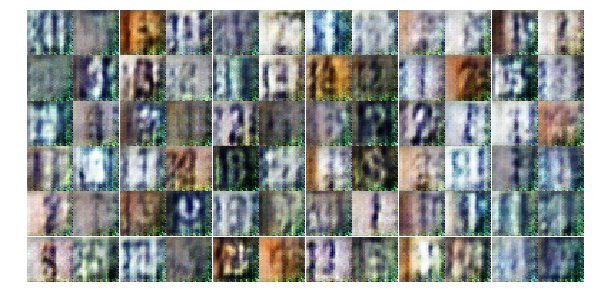

Epoch 8/25... Discriminator Loss: 1.2691... Generator Loss: 0.7399
Epoch 8/25... Discriminator Loss: 1.3274... Generator Loss: 0.7193
Epoch 8/25... Discriminator Loss: 1.2742... Generator Loss: 0.7447
Epoch 8/25... Discriminator Loss: 1.2684... Generator Loss: 0.7154
Epoch 8/25... Discriminator Loss: 1.2913... Generator Loss: 0.7800
Epoch 8/25... Discriminator Loss: 1.2649... Generator Loss: 0.7886
Epoch 8/25... Discriminator Loss: 1.2248... Generator Loss: 0.7044
Epoch 8/25... Discriminator Loss: 1.3942... Generator Loss: 0.7943
Epoch 8/25... Discriminator Loss: 1.2653... Generator Loss: 0.6955
Epoch 8/25... Discriminator Loss: 1.3051... Generator Loss: 0.7770


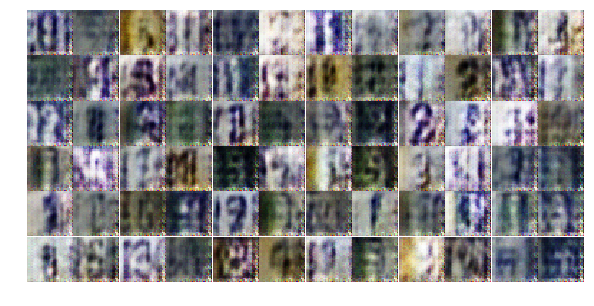

Epoch 8/25... Discriminator Loss: 1.2536... Generator Loss: 0.6832
Epoch 8/25... Discriminator Loss: 1.2539... Generator Loss: 0.7621
Epoch 8/25... Discriminator Loss: 1.2953... Generator Loss: 0.7054
Epoch 8/25... Discriminator Loss: 1.2721... Generator Loss: 0.6500
Epoch 8/25... Discriminator Loss: 1.2452... Generator Loss: 0.7007
Epoch 8/25... Discriminator Loss: 1.3007... Generator Loss: 0.7531
Epoch 8/25... Discriminator Loss: 1.3313... Generator Loss: 0.8153
Epoch 8/25... Discriminator Loss: 1.2936... Generator Loss: 0.7762
Epoch 9/25... Discriminator Loss: 1.2715... Generator Loss: 0.7610
Epoch 9/25... Discriminator Loss: 1.3010... Generator Loss: 0.7628


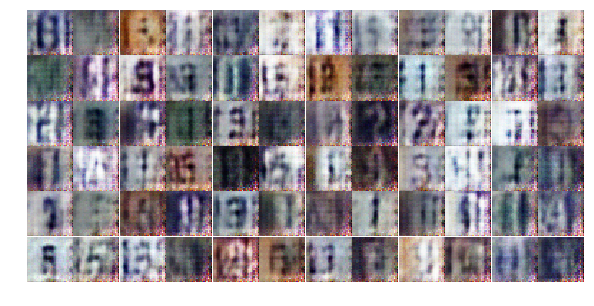

Epoch 9/25... Discriminator Loss: 1.2891... Generator Loss: 0.7068
Epoch 9/25... Discriminator Loss: 1.2979... Generator Loss: 0.7241
Epoch 9/25... Discriminator Loss: 1.2829... Generator Loss: 0.7347
Epoch 9/25... Discriminator Loss: 1.3406... Generator Loss: 0.7278
Epoch 9/25... Discriminator Loss: 1.2851... Generator Loss: 0.7791
Epoch 9/25... Discriminator Loss: 1.3863... Generator Loss: 0.7351
Epoch 9/25... Discriminator Loss: 1.2625... Generator Loss: 0.6916
Epoch 9/25... Discriminator Loss: 1.3153... Generator Loss: 0.7869
Epoch 9/25... Discriminator Loss: 1.3240... Generator Loss: 0.7336
Epoch 9/25... Discriminator Loss: 1.3159... Generator Loss: 0.7451


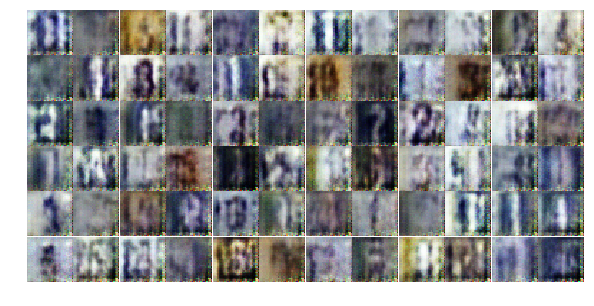

Epoch 9/25... Discriminator Loss: 1.2598... Generator Loss: 0.7291
Epoch 9/25... Discriminator Loss: 1.2680... Generator Loss: 0.7718
Epoch 9/25... Discriminator Loss: 1.3071... Generator Loss: 0.8418
Epoch 9/25... Discriminator Loss: 1.3452... Generator Loss: 0.7668
Epoch 9/25... Discriminator Loss: 1.2949... Generator Loss: 0.6954
Epoch 9/25... Discriminator Loss: 1.3048... Generator Loss: 0.6572
Epoch 9/25... Discriminator Loss: 1.3229... Generator Loss: 0.7624
Epoch 9/25... Discriminator Loss: 1.2893... Generator Loss: 0.7021
Epoch 9/25... Discriminator Loss: 1.3167... Generator Loss: 0.7543
Epoch 9/25... Discriminator Loss: 1.2616... Generator Loss: 0.7343


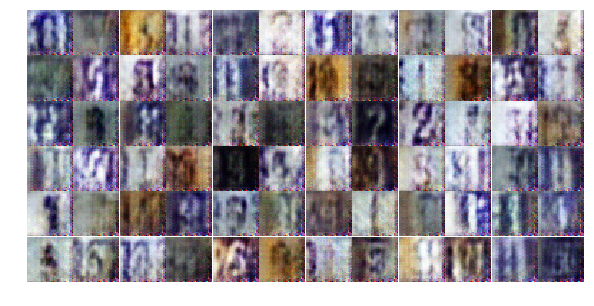

Epoch 9/25... Discriminator Loss: 1.5094... Generator Loss: 0.8597
Epoch 9/25... Discriminator Loss: 1.3320... Generator Loss: 0.7191
Epoch 9/25... Discriminator Loss: 1.3452... Generator Loss: 0.7080
Epoch 9/25... Discriminator Loss: 1.2701... Generator Loss: 0.7607
Epoch 9/25... Discriminator Loss: 1.2372... Generator Loss: 0.7623
Epoch 9/25... Discriminator Loss: 1.2692... Generator Loss: 0.7657
Epoch 9/25... Discriminator Loss: 1.3089... Generator Loss: 0.7310
Epoch 9/25... Discriminator Loss: 1.2993... Generator Loss: 0.7641
Epoch 9/25... Discriminator Loss: 1.2769... Generator Loss: 0.6738
Epoch 9/25... Discriminator Loss: 1.2542... Generator Loss: 0.7106


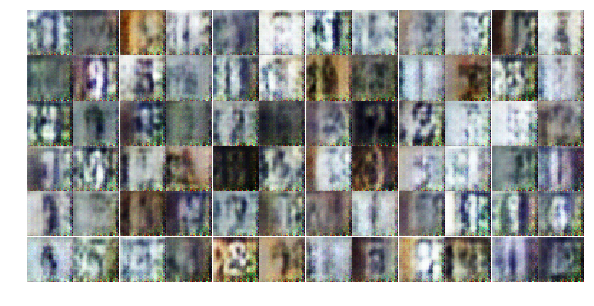

Epoch 9/25... Discriminator Loss: 1.3035... Generator Loss: 0.7259
Epoch 9/25... Discriminator Loss: 1.3225... Generator Loss: 0.7954
Epoch 9/25... Discriminator Loss: 1.3373... Generator Loss: 0.7338
Epoch 9/25... Discriminator Loss: 1.2922... Generator Loss: 0.6924
Epoch 9/25... Discriminator Loss: 1.2738... Generator Loss: 0.7046
Epoch 9/25... Discriminator Loss: 1.3424... Generator Loss: 0.7871
Epoch 9/25... Discriminator Loss: 1.2494... Generator Loss: 0.7959
Epoch 9/25... Discriminator Loss: 1.2502... Generator Loss: 0.7319
Epoch 9/25... Discriminator Loss: 1.3049... Generator Loss: 0.7339
Epoch 9/25... Discriminator Loss: 1.2676... Generator Loss: 0.7653


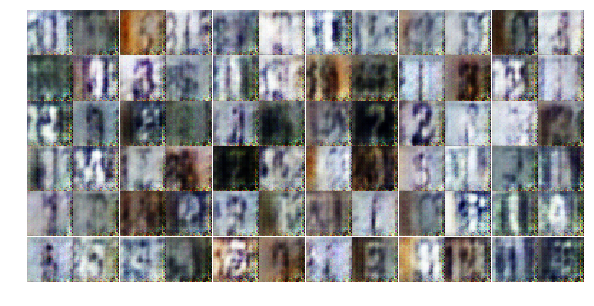

Epoch 9/25... Discriminator Loss: 1.3383... Generator Loss: 0.7953
Epoch 9/25... Discriminator Loss: 1.3088... Generator Loss: 0.7215
Epoch 9/25... Discriminator Loss: 1.2768... Generator Loss: 0.7097
Epoch 9/25... Discriminator Loss: 1.2743... Generator Loss: 0.7375
Epoch 9/25... Discriminator Loss: 1.2370... Generator Loss: 0.7384
Epoch 9/25... Discriminator Loss: 1.3304... Generator Loss: 0.7399
Epoch 9/25... Discriminator Loss: 1.1855... Generator Loss: 0.7457
Epoch 9/25... Discriminator Loss: 1.2765... Generator Loss: 0.8048
Epoch 9/25... Discriminator Loss: 1.2758... Generator Loss: 0.7721
Epoch 9/25... Discriminator Loss: 1.3024... Generator Loss: 0.7393


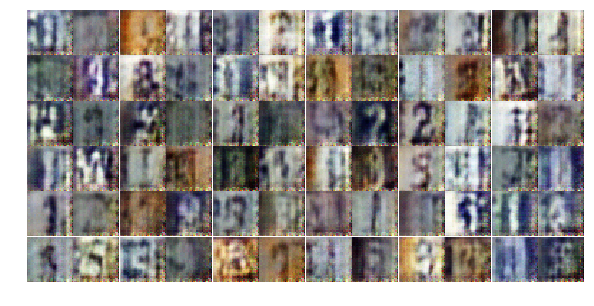

Epoch 9/25... Discriminator Loss: 1.3062... Generator Loss: 0.7684
Epoch 9/25... Discriminator Loss: 1.2988... Generator Loss: 0.7289
Epoch 9/25... Discriminator Loss: 1.2215... Generator Loss: 0.7331
Epoch 9/25... Discriminator Loss: 1.2429... Generator Loss: 0.6722
Epoch 9/25... Discriminator Loss: 1.2857... Generator Loss: 0.7588
Epoch 10/25... Discriminator Loss: 1.2100... Generator Loss: 0.7369
Epoch 10/25... Discriminator Loss: 1.2922... Generator Loss: 0.7658
Epoch 10/25... Discriminator Loss: 1.3341... Generator Loss: 0.8359
Epoch 10/25... Discriminator Loss: 1.3658... Generator Loss: 0.7445
Epoch 10/25... Discriminator Loss: 1.3343... Generator Loss: 0.7972


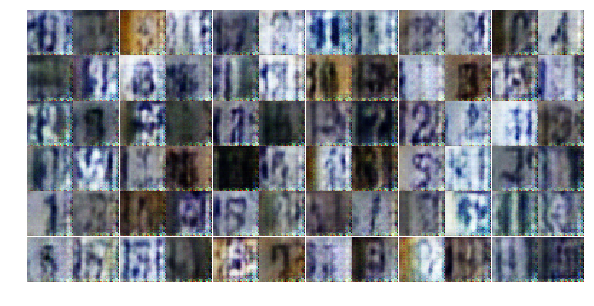

Epoch 10/25... Discriminator Loss: 1.2809... Generator Loss: 0.6548
Epoch 10/25... Discriminator Loss: 1.2550... Generator Loss: 0.6665
Epoch 10/25... Discriminator Loss: 1.2453... Generator Loss: 0.7585
Epoch 10/25... Discriminator Loss: 1.3258... Generator Loss: 0.7255
Epoch 10/25... Discriminator Loss: 1.3299... Generator Loss: 0.7643
Epoch 10/25... Discriminator Loss: 1.2899... Generator Loss: 0.7477
Epoch 10/25... Discriminator Loss: 1.3120... Generator Loss: 0.8411
Epoch 10/25... Discriminator Loss: 1.2669... Generator Loss: 0.7305
Epoch 10/25... Discriminator Loss: 1.2959... Generator Loss: 0.7176
Epoch 10/25... Discriminator Loss: 1.3120... Generator Loss: 0.7599


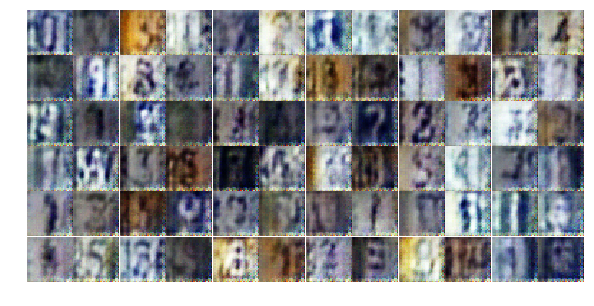

Epoch 10/25... Discriminator Loss: 1.2821... Generator Loss: 0.7568
Epoch 10/25... Discriminator Loss: 1.2495... Generator Loss: 0.7741
Epoch 10/25... Discriminator Loss: 1.2502... Generator Loss: 0.7648
Epoch 10/25... Discriminator Loss: 1.2717... Generator Loss: 0.7513
Epoch 10/25... Discriminator Loss: 1.2825... Generator Loss: 0.7722
Epoch 10/25... Discriminator Loss: 1.2279... Generator Loss: 0.8228
Epoch 10/25... Discriminator Loss: 1.2884... Generator Loss: 0.7608
Epoch 10/25... Discriminator Loss: 1.2869... Generator Loss: 0.7635
Epoch 10/25... Discriminator Loss: 1.3039... Generator Loss: 0.6975
Epoch 10/25... Discriminator Loss: 1.3104... Generator Loss: 0.7275


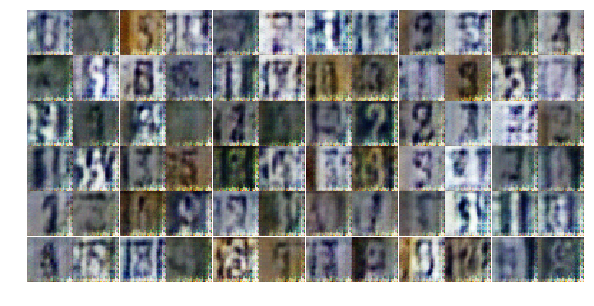

Epoch 10/25... Discriminator Loss: 1.2481... Generator Loss: 0.7352
Epoch 10/25... Discriminator Loss: 1.3167... Generator Loss: 0.6799
Epoch 10/25... Discriminator Loss: 1.2366... Generator Loss: 0.7239
Epoch 10/25... Discriminator Loss: 1.2754... Generator Loss: 0.7392
Epoch 10/25... Discriminator Loss: 1.2728... Generator Loss: 0.7306
Epoch 10/25... Discriminator Loss: 1.2511... Generator Loss: 0.7591
Epoch 10/25... Discriminator Loss: 1.2863... Generator Loss: 0.7091
Epoch 10/25... Discriminator Loss: 1.2786... Generator Loss: 0.7636
Epoch 10/25... Discriminator Loss: 1.2694... Generator Loss: 0.7522
Epoch 10/25... Discriminator Loss: 1.2745... Generator Loss: 0.7489


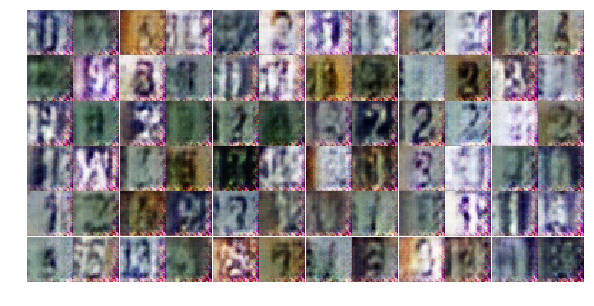

Epoch 10/25... Discriminator Loss: 1.3172... Generator Loss: 0.6741
Epoch 10/25... Discriminator Loss: 1.4632... Generator Loss: 0.7295
Epoch 10/25... Discriminator Loss: 1.3907... Generator Loss: 0.6998
Epoch 10/25... Discriminator Loss: 1.3918... Generator Loss: 0.7091
Epoch 10/25... Discriminator Loss: 1.3500... Generator Loss: 0.7080
Epoch 10/25... Discriminator Loss: 1.3605... Generator Loss: 0.7103
Epoch 10/25... Discriminator Loss: 1.3189... Generator Loss: 0.7364
Epoch 10/25... Discriminator Loss: 1.4228... Generator Loss: 0.7239
Epoch 10/25... Discriminator Loss: 1.3589... Generator Loss: 0.7015
Epoch 10/25... Discriminator Loss: 1.3425... Generator Loss: 0.7172


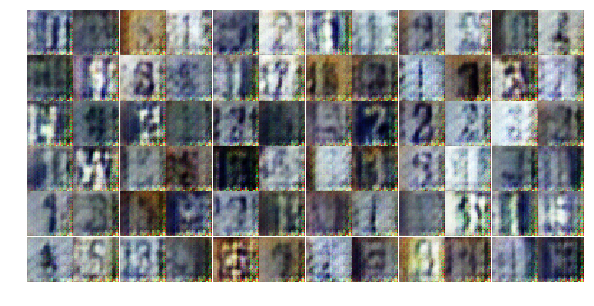

Epoch 10/25... Discriminator Loss: 1.3740... Generator Loss: 0.7169
Epoch 10/25... Discriminator Loss: 1.3467... Generator Loss: 0.7279
Epoch 10/25... Discriminator Loss: 1.3337... Generator Loss: 0.7170
Epoch 10/25... Discriminator Loss: 1.3411... Generator Loss: 0.6978
Epoch 10/25... Discriminator Loss: 1.3448... Generator Loss: 0.7059
Epoch 10/25... Discriminator Loss: 1.3598... Generator Loss: 0.7142
Epoch 10/25... Discriminator Loss: 1.3430... Generator Loss: 0.7286
Epoch 10/25... Discriminator Loss: 1.3236... Generator Loss: 0.7070
Epoch 10/25... Discriminator Loss: 1.3047... Generator Loss: 0.7511
Epoch 10/25... Discriminator Loss: 1.3018... Generator Loss: 0.7180


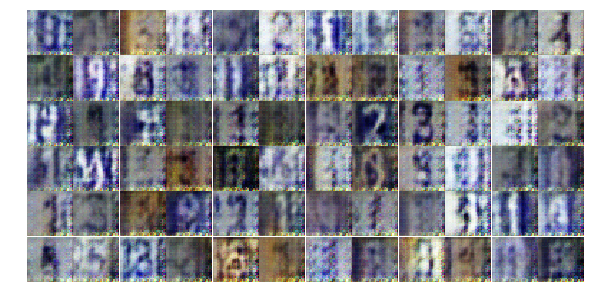

Epoch 10/25... Discriminator Loss: 1.3498... Generator Loss: 0.7305
Epoch 10/25... Discriminator Loss: 1.3114... Generator Loss: 0.7196
Epoch 10/25... Discriminator Loss: 1.3613... Generator Loss: 0.7622
Epoch 11/25... Discriminator Loss: 1.3366... Generator Loss: 0.7247
Epoch 11/25... Discriminator Loss: 1.3289... Generator Loss: 0.7278
Epoch 11/25... Discriminator Loss: 1.2936... Generator Loss: 0.7298
Epoch 11/25... Discriminator Loss: 1.3036... Generator Loss: 0.7578
Epoch 11/25... Discriminator Loss: 1.2637... Generator Loss: 0.7409
Epoch 11/25... Discriminator Loss: 1.2952... Generator Loss: 0.7092
Epoch 11/25... Discriminator Loss: 1.2903... Generator Loss: 0.7226


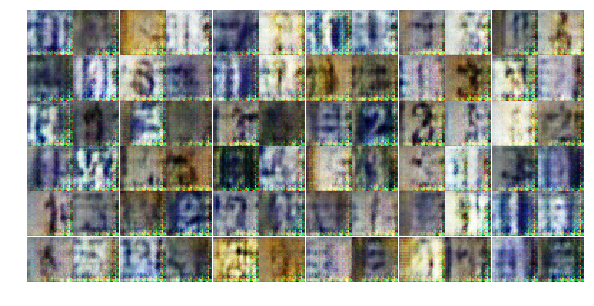

Epoch 11/25... Discriminator Loss: 1.2734... Generator Loss: 0.7338
Epoch 11/25... Discriminator Loss: 1.2833... Generator Loss: 0.7032
Epoch 11/25... Discriminator Loss: 1.2821... Generator Loss: 0.7356
Epoch 11/25... Discriminator Loss: 1.3536... Generator Loss: 0.7210
Epoch 11/25... Discriminator Loss: 1.3636... Generator Loss: 0.6997
Epoch 11/25... Discriminator Loss: 1.2852... Generator Loss: 0.6487
Epoch 11/25... Discriminator Loss: 1.3004... Generator Loss: 0.7692
Epoch 11/25... Discriminator Loss: 1.2620... Generator Loss: 0.7747
Epoch 11/25... Discriminator Loss: 1.3058... Generator Loss: 0.7088
Epoch 11/25... Discriminator Loss: 1.3212... Generator Loss: 0.7176


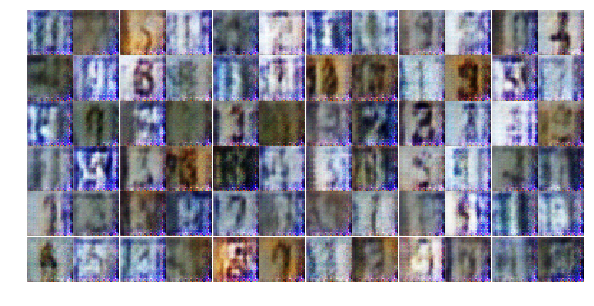

Epoch 11/25... Discriminator Loss: 1.3443... Generator Loss: 0.8123
Epoch 11/25... Discriminator Loss: 1.3162... Generator Loss: 0.6651
Epoch 11/25... Discriminator Loss: 1.3324... Generator Loss: 0.7397
Epoch 11/25... Discriminator Loss: 1.2701... Generator Loss: 0.7093
Epoch 11/25... Discriminator Loss: 1.2548... Generator Loss: 0.7074
Epoch 11/25... Discriminator Loss: 1.2704... Generator Loss: 0.7708
Epoch 11/25... Discriminator Loss: 1.2443... Generator Loss: 0.7592
Epoch 11/25... Discriminator Loss: 1.3222... Generator Loss: 0.7050
Epoch 11/25... Discriminator Loss: 1.2796... Generator Loss: 0.7275
Epoch 11/25... Discriminator Loss: 1.3249... Generator Loss: 0.7329


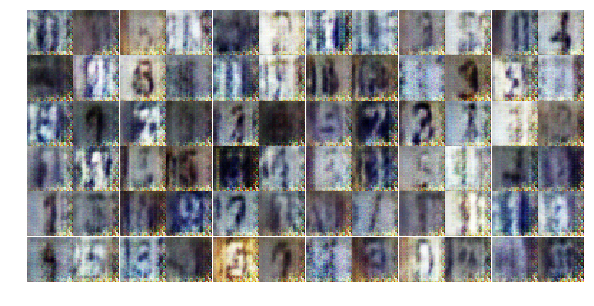

Epoch 11/25... Discriminator Loss: 1.2522... Generator Loss: 0.6794
Epoch 11/25... Discriminator Loss: 1.2912... Generator Loss: 0.7913
Epoch 11/25... Discriminator Loss: 1.3008... Generator Loss: 0.7036
Epoch 11/25... Discriminator Loss: 1.2565... Generator Loss: 0.7308
Epoch 11/25... Discriminator Loss: 1.2796... Generator Loss: 0.7391
Epoch 11/25... Discriminator Loss: 1.2841... Generator Loss: 0.7373
Epoch 11/25... Discriminator Loss: 1.2315... Generator Loss: 0.7237
Epoch 11/25... Discriminator Loss: 1.2090... Generator Loss: 0.8141
Epoch 11/25... Discriminator Loss: 1.2542... Generator Loss: 0.7534
Epoch 11/25... Discriminator Loss: 1.2990... Generator Loss: 0.7047


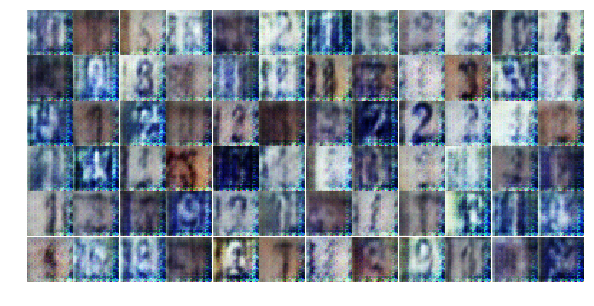

Epoch 11/25... Discriminator Loss: 1.2788... Generator Loss: 0.8364
Epoch 11/25... Discriminator Loss: 1.3445... Generator Loss: 0.8031
Epoch 11/25... Discriminator Loss: 1.2858... Generator Loss: 0.7820
Epoch 11/25... Discriminator Loss: 1.3096... Generator Loss: 0.6990
Epoch 11/25... Discriminator Loss: 1.2863... Generator Loss: 0.6934
Epoch 11/25... Discriminator Loss: 1.2659... Generator Loss: 0.6839
Epoch 11/25... Discriminator Loss: 1.2867... Generator Loss: 0.7689
Epoch 11/25... Discriminator Loss: 1.2563... Generator Loss: 0.7573
Epoch 11/25... Discriminator Loss: 1.2520... Generator Loss: 0.7877
Epoch 11/25... Discriminator Loss: 1.3013... Generator Loss: 0.7408


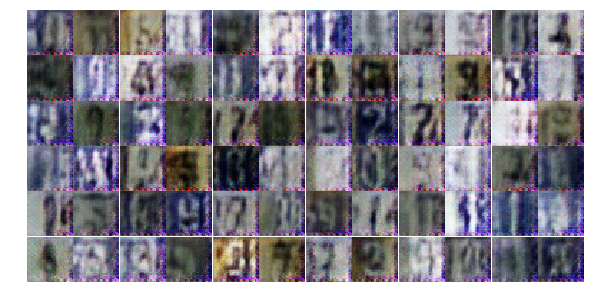

Epoch 11/25... Discriminator Loss: 1.2789... Generator Loss: 0.7607
Epoch 11/25... Discriminator Loss: 1.2375... Generator Loss: 0.7045
Epoch 11/25... Discriminator Loss: 1.3008... Generator Loss: 0.7147
Epoch 11/25... Discriminator Loss: 1.2565... Generator Loss: 0.7797
Epoch 11/25... Discriminator Loss: 1.4048... Generator Loss: 0.6699
Epoch 11/25... Discriminator Loss: 1.2466... Generator Loss: 0.7200
Epoch 11/25... Discriminator Loss: 1.2505... Generator Loss: 0.7403
Epoch 11/25... Discriminator Loss: 1.3529... Generator Loss: 0.7267
Epoch 11/25... Discriminator Loss: 1.2948... Generator Loss: 0.7296
Epoch 11/25... Discriminator Loss: 1.3308... Generator Loss: 0.7332


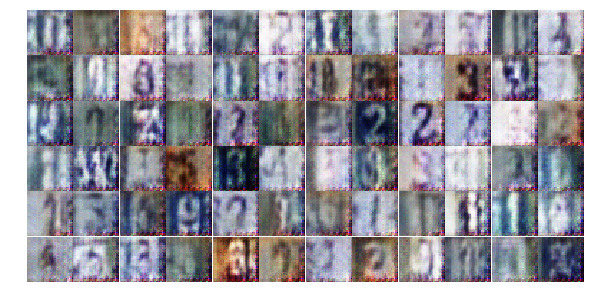

Epoch 12/25... Discriminator Loss: 1.2368... Generator Loss: 0.7582
Epoch 12/25... Discriminator Loss: 1.3041... Generator Loss: 0.7392
Epoch 12/25... Discriminator Loss: 1.2804... Generator Loss: 0.7849
Epoch 12/25... Discriminator Loss: 1.2849... Generator Loss: 0.7303
Epoch 12/25... Discriminator Loss: 1.2670... Generator Loss: 0.7067
Epoch 12/25... Discriminator Loss: 1.2278... Generator Loss: 0.7453
Epoch 12/25... Discriminator Loss: 1.2846... Generator Loss: 0.7274
Epoch 12/25... Discriminator Loss: 1.2625... Generator Loss: 0.7257
Epoch 12/25... Discriminator Loss: 1.2616... Generator Loss: 0.7952
Epoch 12/25... Discriminator Loss: 1.2907... Generator Loss: 0.6975


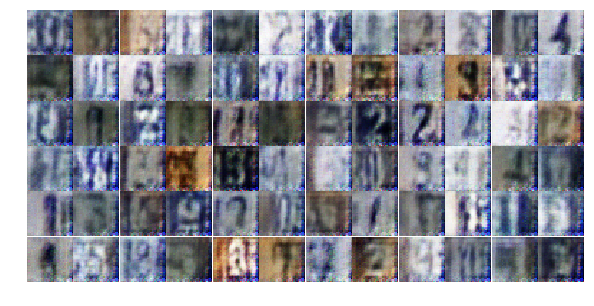

Epoch 12/25... Discriminator Loss: 1.2268... Generator Loss: 0.7580


In [ ]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

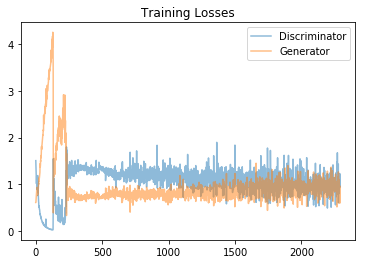

In [21]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

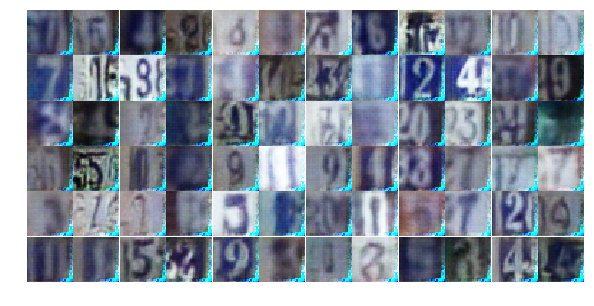

In [22]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))